<a href="https://colab.research.google.com/github/anosha2001/cluster-analysis/blob/main/Cluster_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Assignment: 3 (Cluster Analysis, Logistic Regression and Association Rule Mining)**

**Instructions:**

* Submit your assignment through Google Classroom by the deadline. Late submissions will not be accepted.

* Submit your code as a single **Jupyter/Google Colab notebook**, following the filename format: e.g., **21L-1234.ipynb**. Ensure the notebook includes **clear code** and **visible outputs** for each question.

* Thoroughly understand your code and its functionalities, as a **viva** will be conducted during the evaluation.

* Any form of academic dishonesty (e.g. **plagiarism**, copying code from other sources,
sharing code with other students) is strictly prohibited and will result in disciplinary action. The
individuals involved will get **zero** in this assignment and **50%** deductions in assignments to come.

# **Cluster Analysis**

### **Scenario:**

You are hired as a **Junior Data Scientist** in a company that specializes in building intelligent plant classification systems for botanical gardens. Your first project is to analyze a dataset containing measurements of flower **sepal** and **petal** features.

The goal is to **group the flowers into distinct categories** based on their measurements, using **unsupervised learning techniques**, and provide **visual insights** for the company's research team.

You will apply two clustering techniques:

- **K-Means Clustering**
- **K-Medoids Clustering**

You will also **compare the results** to decide which clustering technique works better for the given data.

The dataset provided contains the following features:

- Sepal Length
- Sepal Width
- Petal Length
- Petal Width

In [ ]:
import pandas as pd
from sklearn.datasets import load_iris

# Load the Iris dataset
iris = load_iris()

# Create a DataFrame with feature data
df = pd.DataFrame(data=iris.data, columns=iris.feature_names)

# Display the first few rows
print(df.head())

   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)
0                5.1               3.5                1.4               0.2
1                4.9               3.0                1.4               0.2
2                4.7               3.2                1.3               0.2
3                4.6               3.1                1.5               0.2
4                5.0               3.6                1.4               0.2


## **Task 1: K-Means Clustering**

### Preprocess the Dataset:
- Preprocess the loaded dataset containing sepal and petal features.
- Handle any missing values appropriately.
- Normalize the feature values (so that clustering is not biased by the scale of features).

### Apply K-Means Clustering:
- Choose an appropriate value for **K** (Use the Elbow Method to decide).
- Apply K-Means clustering to segment the dataset into clusters.

### Visualization:
- Reduce the dimensions of your dataset to **2 principal components** using **PCA**.
- Plot the clusters on a 2D scatter plot, showing each cluster with a different color.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Load the Iris dataset
iris = load_iris()
df = pd.DataFrame(data=iris.data, columns=iris.feature_names)

# Check for missing values
print(df.isnull().sum())

# Normalize the feature values
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df)

# Now 'scaled_features' is ready for clustering


sepal length (cm)    0
sepal width (cm)     0
petal length (cm)    0
petal width (cm)     0
dtype: int64


In [ ]:
!pip install kneed

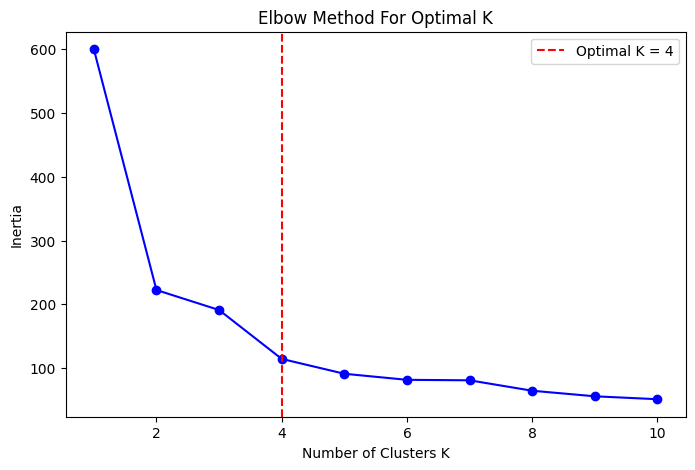

Optimal number of clusters (K) found: 4


In [ ]:
from kneed import KneeLocator  # kneed library automatically finds the 'knee' point

# Find inertia for different K values
inertia = []
K_range = range(1, 11)

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_features)
    inertia.append(kmeans.inertia_)

# Use KneeLocator to automatically find the elbow
knee_locator = KneeLocator(K_range, inertia, curve="convex", direction="decreasing")
optimal_k = knee_locator.elbow

# Plot the Elbow graph
plt.figure(figsize=(8,5))
plt.plot(K_range, inertia, 'bo-')
plt.axvline(x=optimal_k, color='red', linestyle='--', label=f'Optimal K = {optimal_k}')
plt.xlabel('Number of Clusters K')
plt.ylabel('Inertia')
plt.title('Elbow Method For Optimal K')
plt.legend()
plt.show()

print(f"Optimal number of clusters (K) found: {optimal_k}")


In [ ]:
# Apply KMeans using the optimal K
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
cluster_labels = kmeans.fit_predict(scaled_features)

# Add cluster labels to the original dataframe
df['Cluster'] = cluster_labels

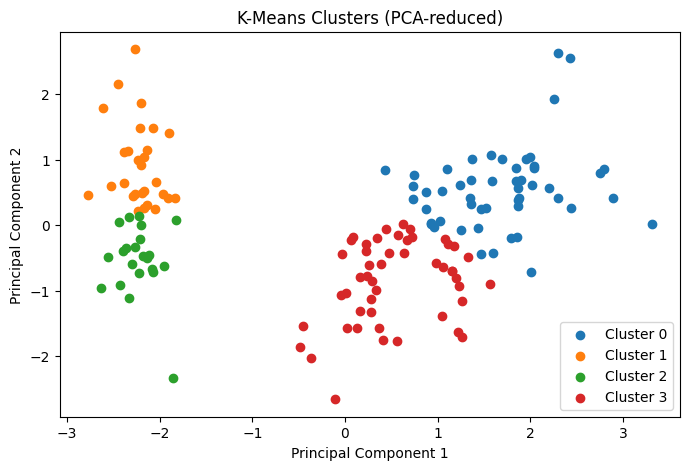

In [ ]:
# Reduce dimensions to 2D for visualization
pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)

# Create a DataFrame with PCA results
pca_df = pd.DataFrame(pca_features, columns=['PC1', 'PC2'])
pca_df['Cluster'] = cluster_labels

# Plot the clusters
plt.figure(figsize=(8,5))
for cluster in sorted(pca_df['Cluster'].unique()):
    cluster_data = pca_df[pca_df['Cluster'] == cluster]
    plt.scatter(cluster_data['PC1'], cluster_data['PC2'], label=f'Cluster {cluster}')

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('K-Means Clusters (PCA-reduced)')
plt.legend()
plt.show()


## **Task 2: K-Medoids Clustering**

### Implement K-Medoids Clustering:
- Using the same preprocessed dataset, apply **K-Medoids clustering**.
- Choose the same number of clusters (**K**) as selected in K-Means.

### Visualization:
- Reduce the dimensions of your dataset using **PCA**.
- Plot the resulting clusters on a 2D scatter plot.
- Use different colors for different clusters.

### Comparison with K-Means:
- Compare the cluster plots generated by K-Medoids and K-Means.
- Comment the differences observed in clustering behavior and robustness to outliers.

In [ ]:
!pip install pyclustering


In [ ]:
import numpy as np
from pyclustering.cluster.kmedoids import kmedoids
from pyclustering.cluster import cluster_visualizer
from pyclustering.utils import calculate_distance_matrix

# Convert scaled_features to list format
data = scaled_features.tolist()

# Calculate distance matrix (optional but improves performance)
distance_matrix = calculate_distance_matrix(data)

In [ ]:
import random

# Randomly select initial medoids (indexes)
initial_medoids = random.sample(range(len(data)), optimal_k)

# Create instance of K-Medoids algorithm
kmedoids_instance = kmedoids(data, initial_medoids, data_type='points')

# Run the clustering process
kmedoids_instance.process()

# Get results
clusters = kmedoids_instance.get_clusters()
medoids = kmedoids_instance.get_medoids()

# Print medoids
print(f"Medoids indices: {medoids}")


Medoids indices: [112, 48, 30, 94]


In [ ]:
# Create a label array
kmedoids_labels = np.zeros(len(data))

for idx, cluster in enumerate(clusters):
    for data_index in cluster:
        kmedoids_labels[data_index] = idx

# Add K-Medoids cluster labels to the dataframe
df['KMedoids_Cluster'] = kmedoids_labels.astype(int)


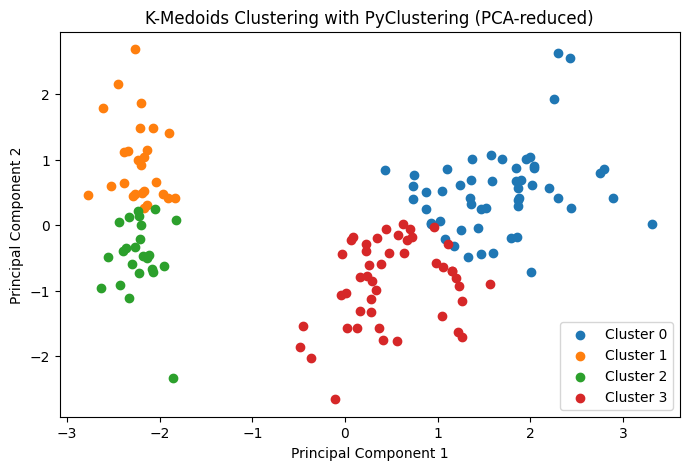

In [ ]:
# Plot K-Medoids clusters using PCA features
pca_df['KMedoids_Cluster'] = kmedoids_labels.astype(int)

# Scatter plot
plt.figure(figsize=(8,5))
for cluster in sorted(pca_df['KMedoids_Cluster'].unique()):
    cluster_data = pca_df[pca_df['KMedoids_Cluster'] == cluster]
    plt.scatter(cluster_data['PC1'], cluster_data['PC2'], label=f'Cluster {cluster}')

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('K-Medoids Clustering with PyClustering (PCA-reduced)')
plt.legend()
plt.show()


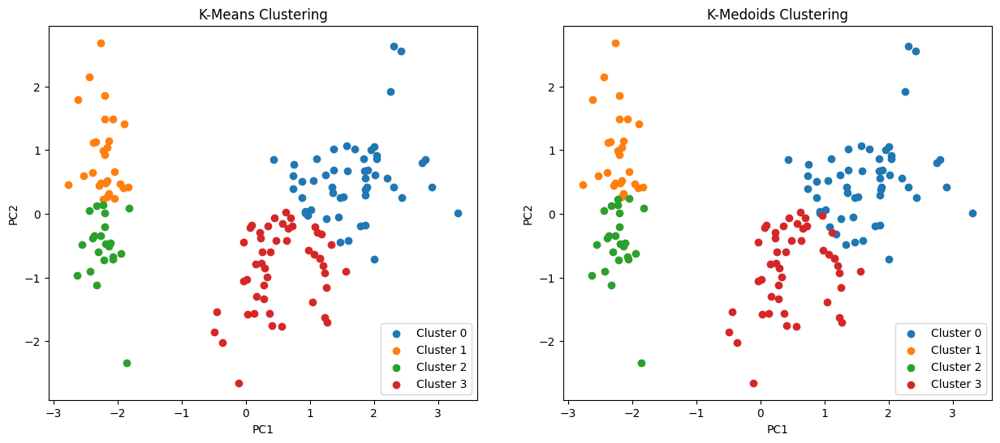

In [ ]:
# Plot side by side comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,6))

# K-Means plot
for cluster in sorted(pca_df['Cluster'].unique()):
    cluster_data = pca_df[pca_df['Cluster'] == cluster]
    ax1.scatter(cluster_data['PC1'], cluster_data['PC2'], label=f'Cluster {cluster}')
ax1.set_title('K-Means Clustering')
ax1.set_xlabel('PC1')
ax1.set_ylabel('PC2')
ax1.legend()

# K-Medoids plot
for cluster in sorted(pca_df['KMedoids_Cluster'].unique()):
    cluster_data = pca_df[pca_df['KMedoids_Cluster'] == cluster]
    ax2.scatter(cluster_data['PC1'], cluster_data['PC2'], label=f'Cluster {cluster}')
ax2.set_title('K-Medoids Clustering')
ax2.set_xlabel('PC1')
ax2.set_ylabel('PC2')
ax2.legend()

plt.show()


K-Means clustering forms spherical clusters by minimizing the variance (inertia) around the centroids (means).

K-Medoids clustering forms clusters around actual data points (medoids), which makes it more robust to outliers.

For clean, simple data — both methods perform similarly.
For data with outliers or noise — K-Medoids is often more reliable.

# **Logistic Regression**

## **Task 3: Logistic Regression Using K-Means Predicted Labels**

### Train a Logistic Regression Model:
- Use the **K-Means predicted cluster labels** as the **target labels**.
- Train a **Logistic Regression** classifier on the normalized features.

### Evaluation:
- Evaluate the classifier performance (accuracy score, precision score, recall score and f-score).

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.preprocessing import StandardScaler


kmeans_labels = kmeans.fit_predict(scaled_features)
df['KMeans_Cluster'] = kmeans_labels

X = df[iris.feature_names]
y = df['KMeans_Cluster']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Logistic Regression model
logreg = LogisticRegression(max_iter=200)

# Train the model
logreg.fit(X_train, y_train)

# Predict the labels on the test set
y_pred = logreg.predict(X_test)

# Evaluate the classifier performance
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted', zero_division=1)
recall = recall_score(y_test, y_pred, average='weighted', zero_division=1)
f1 = f1_score(y_test, y_pred, average='weighted', zero_division=1)

# Print the evaluation results
print("Logistic Regression Evaluation:")
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Logistic Regression Evaluation:
Accuracy: 0.9778
Precision: 0.9806
Recall: 0.9778
F1 Score: 0.9780


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# **Mining Association Rules Using Apriori Algorithm**

A database has four transactions:

| TID  | Items Bought        |
|------|---------------------|
| T100 | {A, B, D, K}         |
| T200 | {A, B, C, D, E}      |
| T300 | {A, B, C, E}         |
| T400 | {A, B, D}            |

### **Task 4:**

- **Find all frequent itemsets** using the **Apriori algorithm** with:
  - Minimum support (**min_sup**) = 3  
  (i.e., any itemset occurring in fewer than 3 transactions is considered infrequent).

- **List all strong association rules** generated from the frequent itemsets with:
  - **min_sup = 3**
  - **min_conf = 80%**

# Attach Image of the Handwritten Solution here..

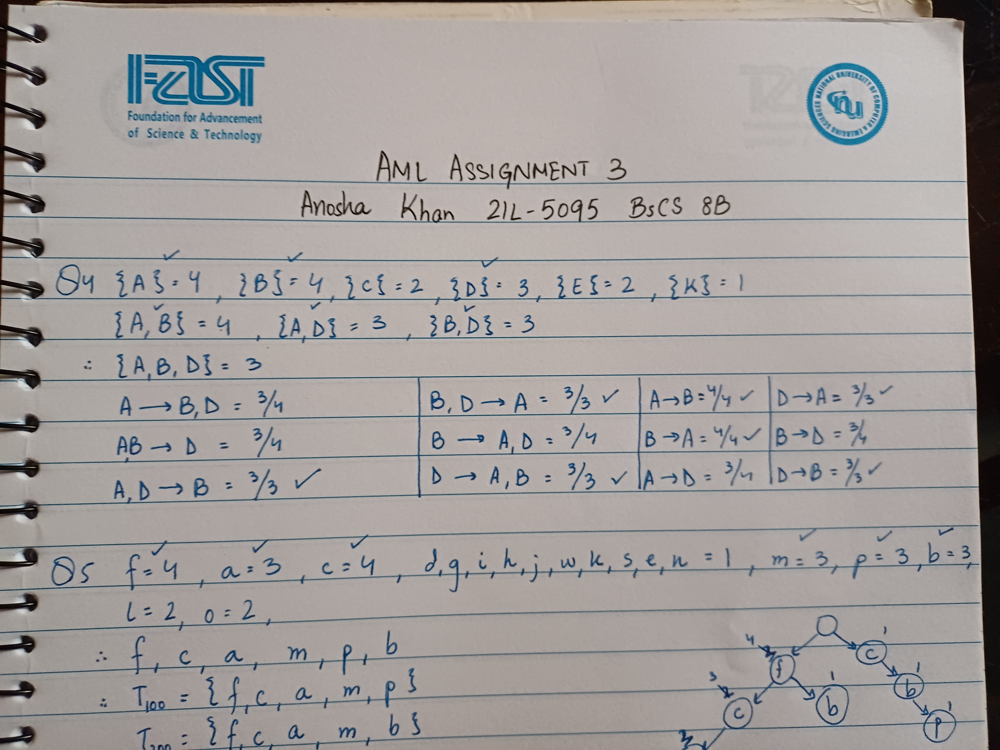

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Path to the image
image_path = '/content/20250504_170156.jpg'  # Replace with your actual image path or upload via Colab

# Read the image
image = cv2.imread(image_path)

# Check if the image loaded successfully
if image is None:
    print("Error: Could not load image.")
else:
    # Display the image in Colab
    cv2_imshow(image)


# **Mining Association Rules Using FP-Growth Algorithm**

A database contains the following transactions:

| TID  | Items Bought (ordered)          |
|------|----------------------------------|
| 100  | {f, a, c, d, g, i, m, p}          |
| 200  | {a, b, c, f, l, m, o}             |
| 300  | {b, f, h, j, o, w}                |
| 400  | {b, c, k, s, p}                   |
| 500  | {a, f, c, e, l, p, m, n}           |

### **Task 5:**

Use the **FP-Growth algorithm** to find all **frequent itemsets** with:

**Minimum support = 3**  
  (i.e., any itemset appearing in less than 3 transactions is considered infrequent).

# Attach Image of the Handwritten Solution here..

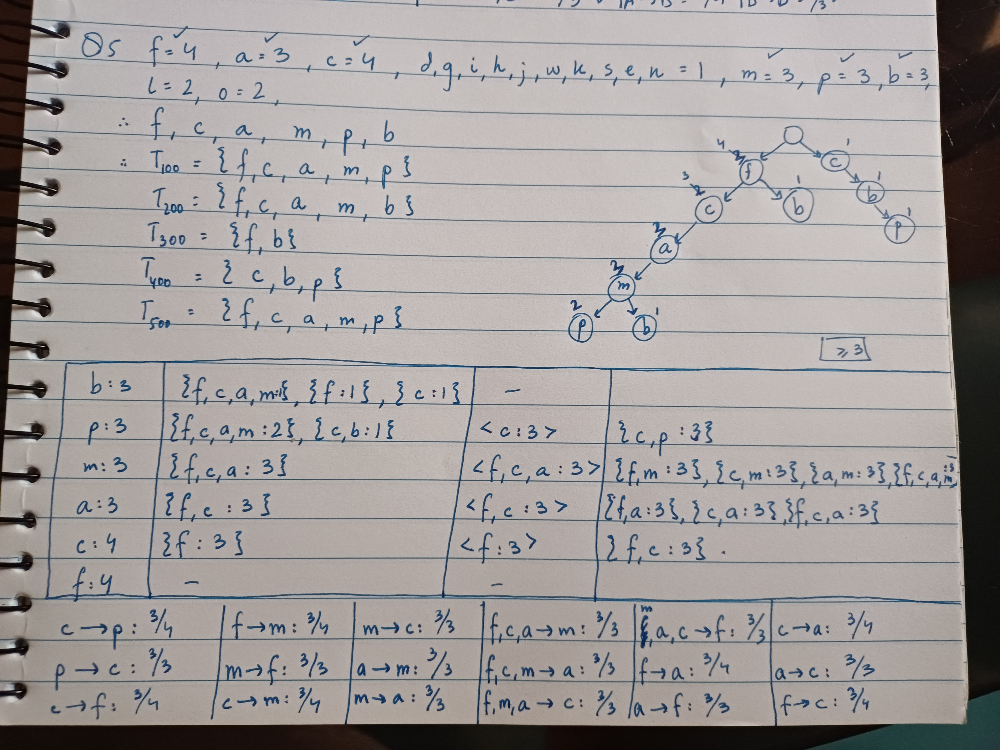

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Path to the image
image_path = '/content/20250504_170209.jpg'  # Replace with your actual image path or upload via Colab

# Read the image
image = cv2.imread(image_path)

# Check if the image loaded successfully
if image is None:
    print("Error: Could not load image.")
else:
    # Display the image in Colab
    cv2_imshow(image)
